In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for di+rname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [1]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
from PIL import Image

import warnings
warnings.filterwarnings('ignore')

In [25]:
# industry_df = pd.read_csv('/kaggle/input/industry-df/industry.csv')
industry_df = pd.read_csv('/kaggle/input/industry-df-final/new_industry.csv')

industry_df.loc[industry_df['industry'].str.contains('&'), ['industry']] = 'hospital and health care'

In [26]:
import torch
import torchvision
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
from skimage import io, transform

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


# Importing resnet18
densenet121 = torchvision.models.densenet121(pretrained=True)

# Extracting all layers of resnet18 without the final classification layer
densenet121_layers = list(densenet121.children())[:-1]

# Creating modified resnet18 with all layers except final classification layer
densenet121_mod = torch.nn.Sequential(*densenet121_layers)

densenet121_mod.eval()
densenet121_mod = densenet121_mod.to(device)

img_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ])

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [27]:
# error_index = []
# countries = company_loc_sample['country']
def build_image_list_industry(industry):
    images = []
    company_list = list(industry_df[industry_df["industry"] == industry]["name"])

    # if type == 'sample':
    #   company_list = good_company[country]
    # else:
    for company_name in company_list:

        try:
            img_name = company_name + ".jpg"
            img = io.imread("/kaggle/input/industry-logos/industry/{0}/{1}.jpg".format(industry, company_name))

            # Ensure correct shape and type
            if img.ndim == 2:  # If grayscale
                img = np.stack((img,) * 3, axis=-1)
            elif img.ndim > 3:  # If extra dimensions
                img = np.squeeze(img)
                if img.ndim > 3:  # If still more than 3 dimensions
                    img = img.reshape(img.shape[-3:])

            # Ensure it's uint8
            if img.dtype != np.uint8:
                if img.max() <= 1.0:
                    img = (img * 255).astype(np.uint8)
                else:
                    img = img.astype(np.uint8)

            images.append(img)
            # i += 1
        except:
            # print(i, companyname)
            # images.append('error')
            # print(industryname)
            industry_df.drop(industry_df[industry_df['name'] == company_name].index, inplace=True)

    return images


In [28]:
# error_index = []
# countries = company_loc_sample['country']
def clean_image_list_industry(industry):
    # images = []
    company_list = list(industry_df[industry_df["industry"] == industry]["name"])

    # if type == 'sample':
    #   company_list = good_company[country]
    # else:
    for company_name in company_list:

        try:
            img_name = company_name + ".jpg"
            if not(os.path.exists("/kaggle/input/industry-logos/industry/{0}/{1}.jpg".format(industry, company_name))):
                industry_df.drop(industry_df[industry_df['name'] == company_name].index, inplace=True)
        except:
            pass
            

    # return images


In [29]:
len(industry_df[industry_df["industry"] == 'management consulting']["name"])

12000

In [30]:
for industry in os.listdir('/kaggle/input/sorted-images/sorted_images'):
    clean_image_list_industry(industry)

In [2]:
from torch.utils.data import DataLoader, Dataset
from PIL import Image
import cv2
err_index = []
class CompanyLogoDataset(Dataset):
    def __init__(self, company_list, transform, industry, label_encoder=None):
        self.company_list = company_list
        self.transform = transform
        self.industry = industry
        self.error_index = []
        self.label_encoder = label_encoder
    
    def __len__(self):
        return len(self.company_list)

    def trim_whitespace_cv2(image_path):
        img = cv2.imread(image_path)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        gray = 255*(gray < 128).astype(np.uint8)
        gray = cv2.morphologyEx(gray, cv2.MORPH_OPEN, np.ones((2, 2), dtype=np.uint8))
        coords = cv2.findNonZero(gray)
        x, y, w, h = cv2.boundingRect(coords)
        cropped = img[y:y+h, x:x+w]
        
        # Convert BGR to RGB for matplotlib
        cropped_rgb = cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB)
        
        return cropped_rgb

    def __getitem__(self, idx):
        company_name = self.company_list[idx]
        industry_name = self.industry[idx]
        if self.label_encoder:
            label = self.label_encoder.transform([industry_name])
        else:
            label = industry_name
        try:
            # logo = self.trim_whitespace_cv2("/kaggle/input/industry-logos/industry/{0}/{1}.jpg".format(industry_name, company_name))
            logo = io.imread("/kaggle/input/industry-logos/industry/{0}/{1}.jpg".format(industry_name, company_name))

        # Handle singleton dimension in the first axis
            if logo.shape[0] == 1:
                logo = np.squeeze(logo, axis=0)  # Remove the first dimension
    
            
            # Handle different image formats
            if logo.ndim == 2:  # Grayscale
                logo = np.stack((logo,)*3, axis=-1)
            elif logo.ndim > 3:  # Extra dimensions
                logo = np.squeeze(logo)
                if logo.ndim > 3:
                    logo = logo.reshape(logo.shape[-3:])
            
            # Ensure uint8 type
            if logo.dtype != np.uint8:
                if logo.max() <= 1.0:
                    logo = (logo * 255).astype(np.uint8)
                else:
                    logo = logo.astype(np.uint8)
    
            
            logo = Image.fromarray(logo).convert('RGB')
            logo_transformed = self.transform(logo)
            return logo_transformed, label
        except Exception as e:
            # print('exception:', e)
            industry_df.drop(industry_df[industry_df['name'] == company_name].index, inplace=True)
            self.error_index.append(idx)
            return torch.zeros((3, 224, 224)), label
            

        
        
        

In [44]:
def getEmbeddings(company_logo_dataloader):
    industry_logo_embeddings = []
    i = 0
    with torch.no_grad():
        for batch, label in company_logo_dataloader:
            batch = batch.to(device)
            print(i, end=' ')
            i += 1
            embedding = densenet121_mod(batch)
            # Ensure consistent shape regardless of batch size
            if len(embedding.shape) == 4:  # If using features before avgpool
                # Global average pooling
                embedding = torch.mean(embedding, dim=[2, 3])
            
            # Convert to numpy while maintaining batch dimension
            embedding = embedding.cpu().numpy()
            
            # Ensure 2D shape (batch_size, features)
            if len(embedding.shape) == 1:
                embedding = embedding.reshape(1, -1)
            industry_logo_embeddings.append(embedding)
    industry_logo_embeddings = np.concatenate(industry_logo_embeddings, axis=0)
    return industry_logo_embeddings


In [33]:
def plot_outliers(distance_df, industry):
    fig, ax = plt.subplots(10,10)
    fig.set_size_inches(20, 20)
    fig.tight_layout()
    i = 0
    # j = 0
    while i < 100:
        
        try:
            companyname = distance_df.iloc[i]['companies']
            image = Image.open("/kaggle/input/industry-logos/industry/{0}/{1}.jpg".format(industry, companyname))
            ax[i//10, i%10].set_title(companyname)
            ax[i//10, i%10].imshow(image)
          # j += 1
          
        except:
          pass
    
        i += 1
    

In [67]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
    
le.fit(industry_df['industry'].to_list())

LabelEncoder()

In [35]:
industry_df['industry'].value_counts()

industry
marketing and advertising                     10352
real estate                                   10320
construction                                  10314
software, information technology, internet    10258
management consulting                         10256
financial services                            10200
hospital, health, wellness and fitness        10131
design                                         8102
Name: count, dtype: int64

In [40]:
def get_outliers(industry):
    clean_image_list_industry(industry)
    company_list = list(industry_df[industry_df["industry"] == industry]["name"])
    company_logo_dataset = CompanyLogoDataset(company_list, img_transform, industry)
    company_logo_dataloader = DataLoader(company_logo_dataset, batch_size=64, shuffle=False, pin_memory=True)
    industry_logo_embeddings = getEmbeddings(company_logo_dataloader)
    sampled_companies = os.listdir('/kaggle/input/sorted-images/sorted_images/{}/'.format(industry))

    for i in range(len(sampled_companies)):
        sampled_companies[i] = sampled_companies[i][:-4]

    sampled_company_embeddings = []
    for i in range(len(company_list)):
        if company_list[i] in sampled_companies:
            sampled_company_embeddings.append(industry_logo_embeddings[i])

    sampled_company_embeddings = np.array(sampled_company_embeddings)
    centroid_array = sampled_company_embeddings.mean(axis=0)
    distance_array = np.sqrt(np.sum((centroid_array - industry_logo_embeddings)**2, axis=1))
    distance_df = pd.DataFrame({'companies': company_list, 'distance': distance_array})
    distance_df.sort_values(by='distance', ascending=False, inplace=True)
    plot_outliers(distance_df, industry)
    return distance_df
    

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 

/opt/conda/lib/python3.10/site-packages/PIL/TiffImagePlugin.py:900: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))


43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 

/opt/conda/lib/python3.10/site-packages/PIL/Image.py:3368: DecompressionBombWarning: Image size (138886111 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


149 150 151 152 153 154 155 156 157 158 159 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 

libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error


35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 

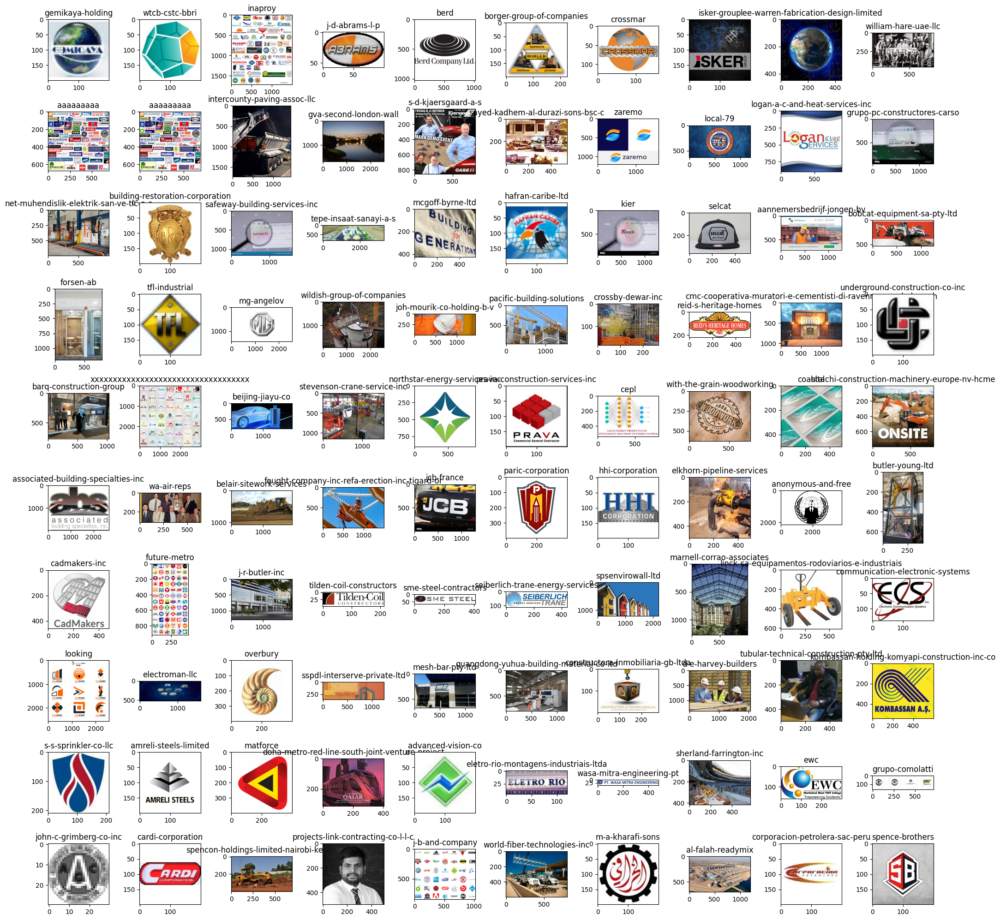

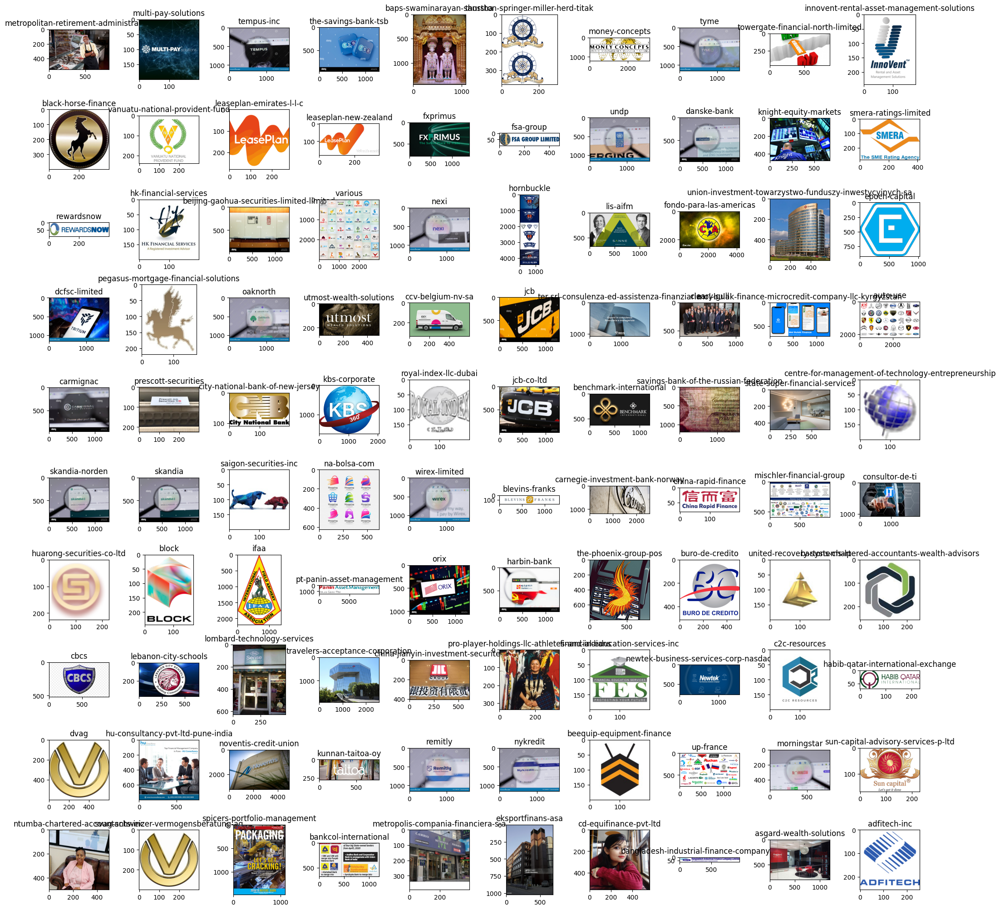

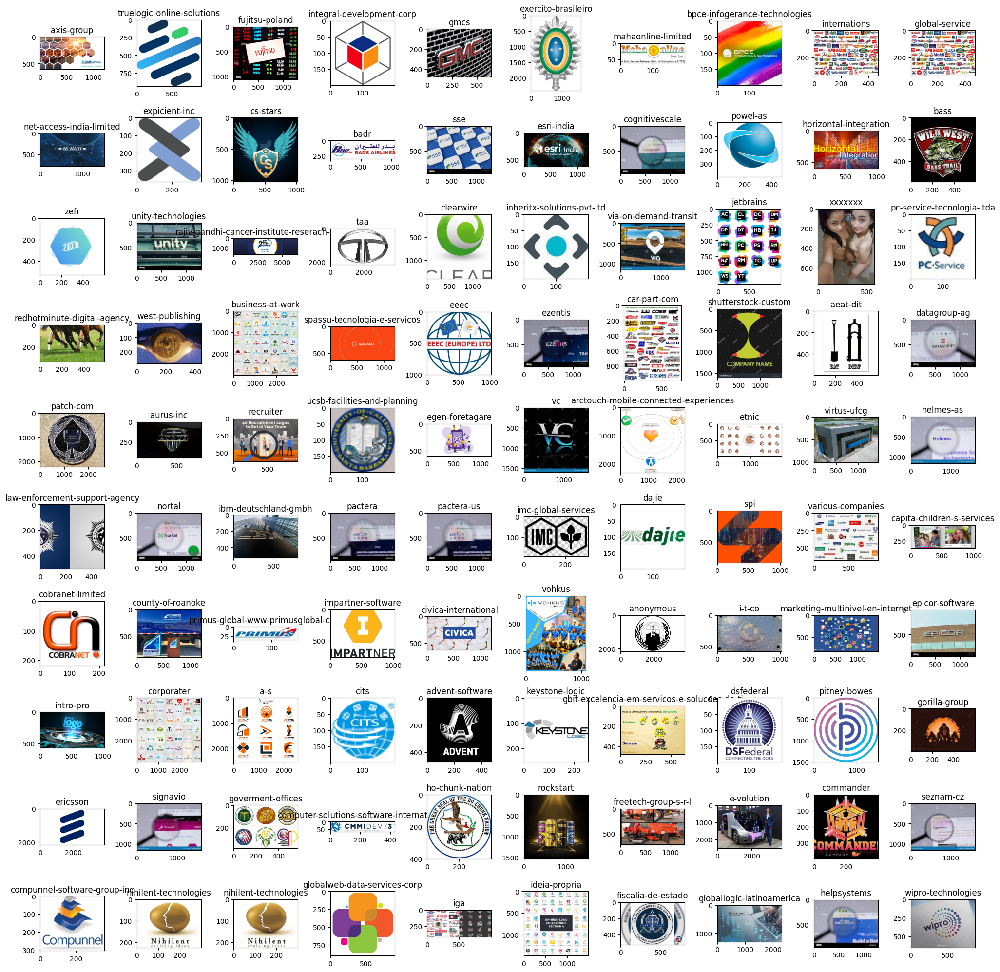

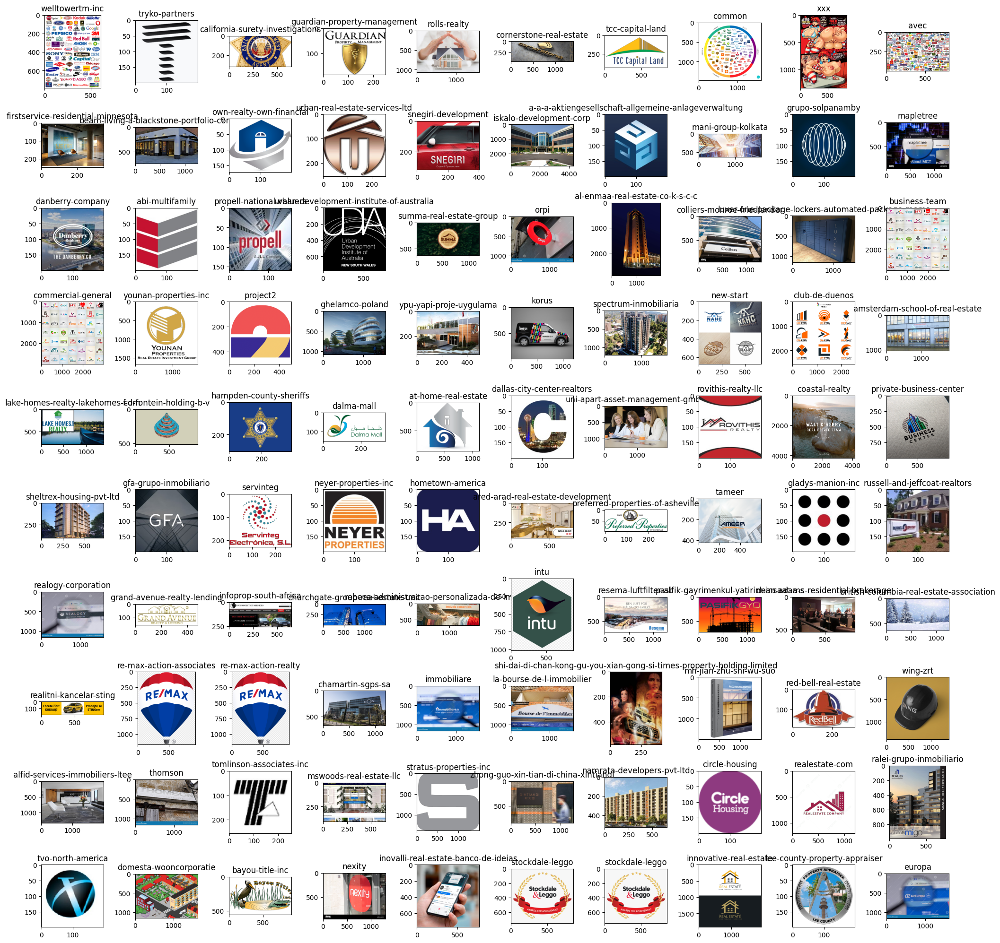

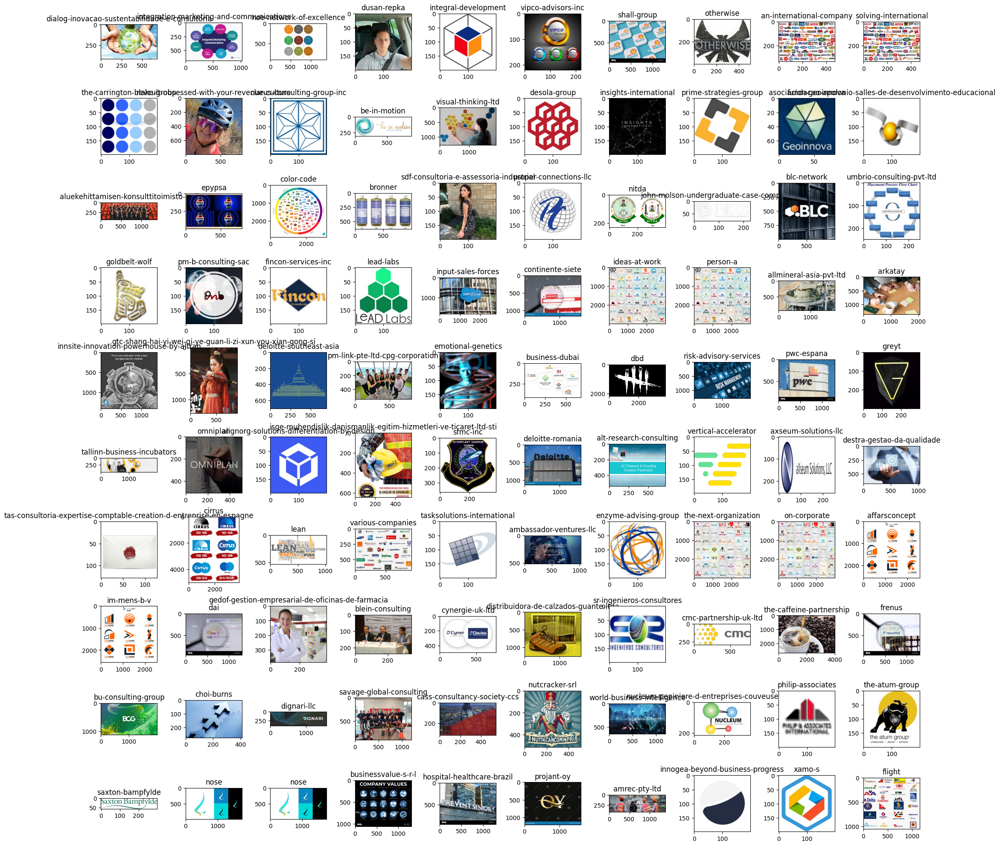

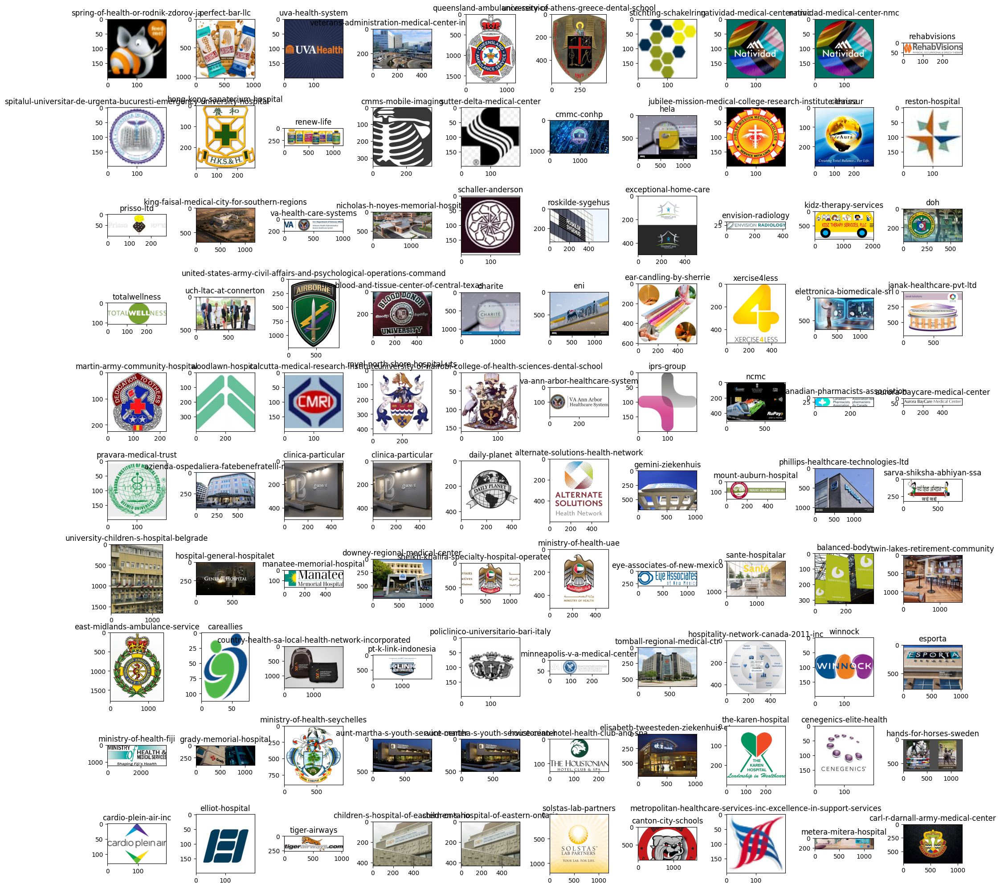

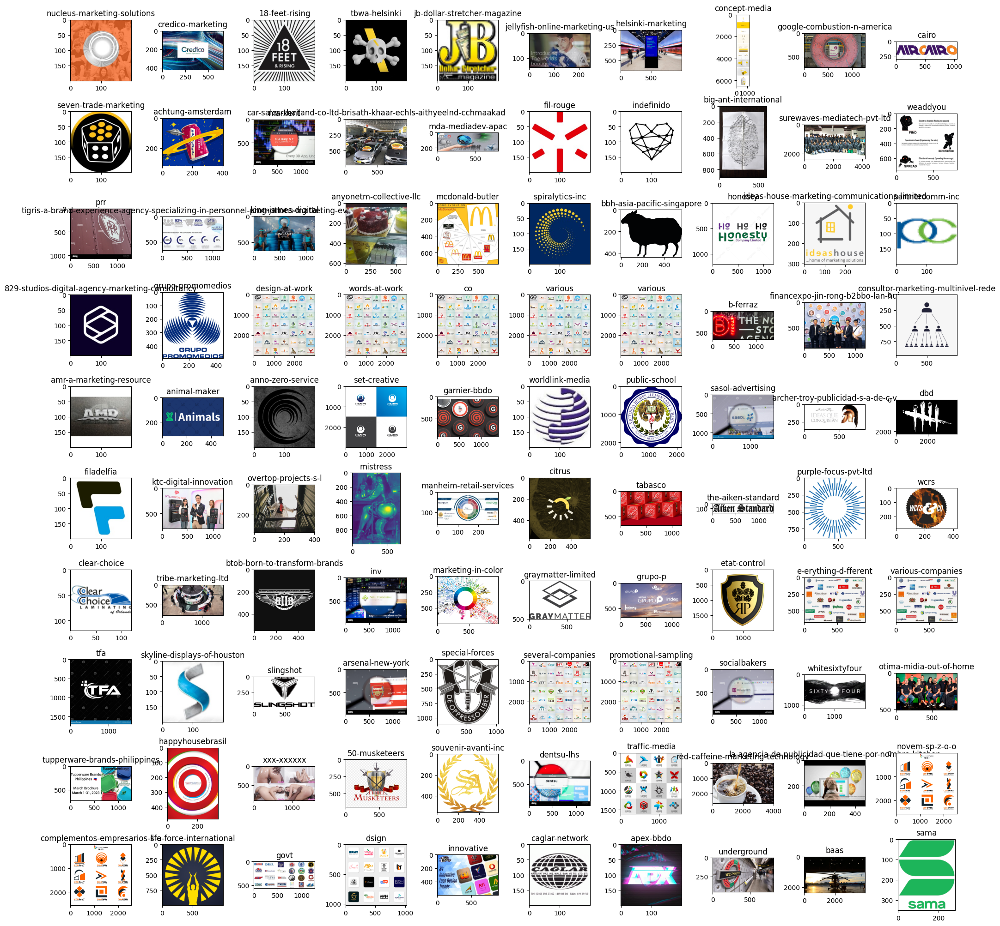

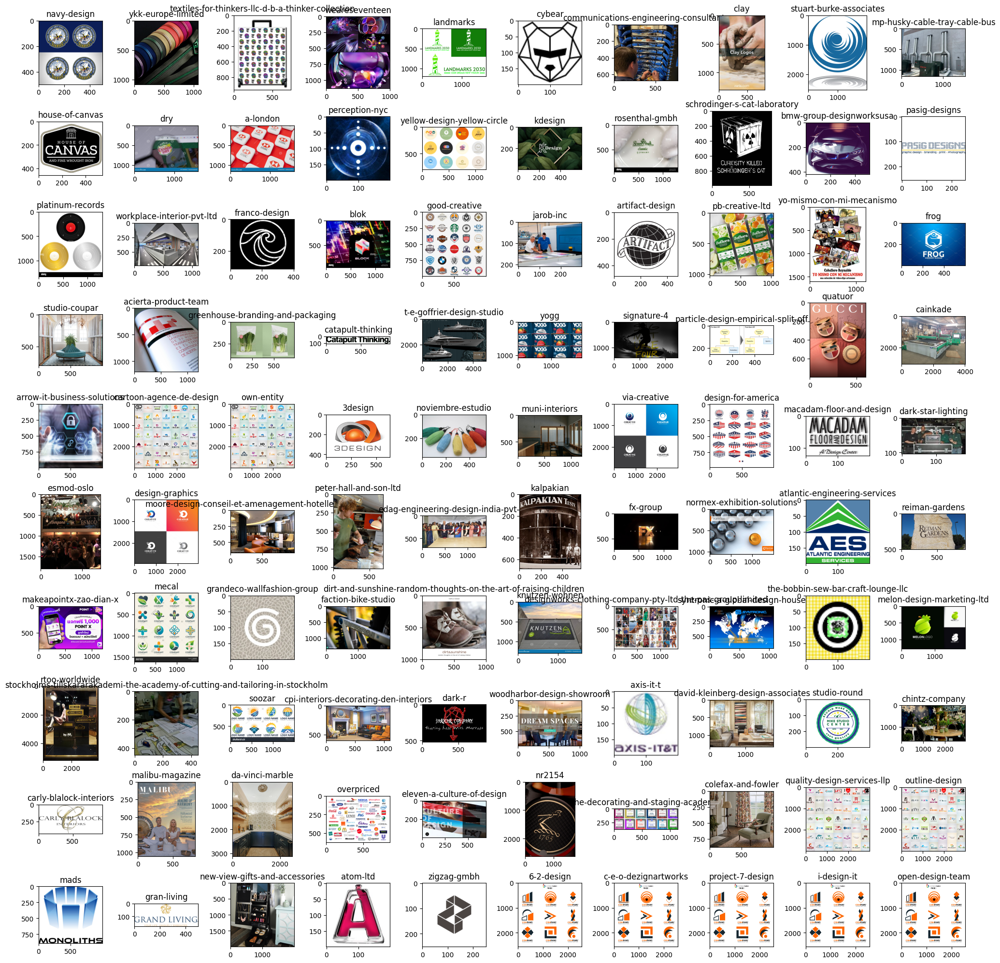

In [45]:
distance_df_dict = {}
for industry in os.listdir('/kaggle/input/sorted-images/sorted_images'):
    distance_df_dict[industry] = get_outliers(industry)

In [ ]:
Image.open('/kaggle/input/industry-logos/industry/financial services/j-p-morgan.jpg')

In [47]:
for key, _df in distance_df_dict.items():
    for index, row in _df.head(500).iterrows():
        company_name = row['companies']
        # os.remove("/kaggle/input/industry-logos/industry/{0}/{1}.jpg".format(industry, company_name))
        industry_df.drop(industry_df[industry_df['name'] == company_name].index, inplace=True)

In [ ]:
industry = 'financial services'
clean_image_list_industry(industry)
company_list = list(industry_df[industry_df["industry"] == industry]["name"])
    # industry_img_list = np.array(industry_img_list, dtype=object)
# valid_industry_companies = np.array(industry_df[industry_df['industry'] == industry]['name'])
company_logo_dataset = CompanyLogoDataset(company_list, img_transform, industry)
company_logo_dataloader = DataLoader(company_logo_dataset, batch_size=16, shuffle=False, pin_memory=True)
industry_logo_embeddings = getEmbeddings(company_logo_dataloader)
sampled_companies = os.listdir('/kaggle/input/sorted-images/sorted_images/{}/'.format(industry))
for i in range(len(sampled_companies)):
    sampled_companies[i] = sampled_companies[i][:-4]

sampled_company_embeddings = []

for i in range(len(company_list)):
        if company_list[i] in sampled_companies:
            sampled_company_embeddings.append(industry_logo_embeddings[i])


sampled_company_embeddings = np.array(sampled_company_embeddings)
centroid_array = sampled_company_embeddings.mean(axis=0)

distance_array = np.sqrt(np.sum((centroid_array - industry_logo_embeddings)**2, axis=1))
distance_df = pd.DataFrame({'companies': company_list, 'distance': distance_array})

distance_df.sort_values(by='distance', ascending=False, inplace=True)

In [ ]:
fig, ax = plt.subplots(10,10)
fig.set_size_inches(20, 20)
fig.tight_layout()
i = 0
# j = 0
while i < 100:
    
    try:
        companyname = distance_df.iloc[i]['companies']
        image = Image.open("/kaggle/input/industry-logos/industry/{0}/{1}.jpg".format(industry, companyname))
        ax[i//10, i%10].set_title(companyname)
        ax[i//10, i%10].imshow(image)
      # j += 1
      
    except:
      pass

    i += 1
    

## Classification

In [1]:
import pandas as pd
import numpy as np

In [3]:
# industry_df = pd.read_csv('/kaggle/input/industry-df-final/industry_df_final.csv')
industry_df = pd.read_csv('/kaggle/input/industry-df-final/industry_df_0312.csv')

industry_df.loc[industry_df['industry'].str.contains('&'), ['industry']] = 'hospital and health care'

In [10]:
for param in model.parameters():
    param.requires_grad = True

In [4]:
from sklearn.model_selection import train_test_split

test_dfs = []
train_dfs = []
for industry, _df in industry_df.groupby(['industry']):
    train_df, test_df = train_test_split(_df, test_size=0.15, random_state=7, shuffle=True)
    test_dfs.append(test_df)
    train_dfs.append(train_df)

train_df = pd.concat(train_dfs, ignore_index=True)
test_df = pd.concat(test_dfs, ignore_index=True)

In [ ]:
from tqdm import tqdm

def get_embeddings(dataset, model, device, batch_size=8, num_workers=2):
    """
    Generate embeddings for a dataset using a given model
    
    Args:
        dataset: PyTorch dataset
        model: Neural network model
        device: torch device (cuda/cpu)
        batch_size: Batch size for DataLoader
        num_workers: Number of workers for DataLoader
    
    Returns:
        embeddings: Tensor of embeddings
        labels: Tensor of corresponding labels
    """
    # Create DataLoader
    dataloader = torch.utils.data.DataLoader(
        dataset, 
        batch_size=batch_size, 
        shuffle=False,
        num_workers=num_workers
    )
    
    # Set model to evaluation mode
    model.eval()
    model.to(device)
    
    # Initialize tensors for embeddings and labels
    embeddings = torch.empty(0, 512).to(device)
    all_labels = torch.empty(0, dtype=torch.int32).to(device)
    
    pbar = tqdm(dataloader, desc='Generating embeddings')
    with torch.no_grad():
        for inputs, labels in pbar:
            inputs = inputs.to(device)
            labels = labels.to(device).to(torch.int32)
            
            # Generate embeddings
            outputs = model(inputs)
            
            # Concatenate batch embeddings and labels
            embeddings = torch.cat([embeddings, outputs], dim=0)
            all_labels = torch.cat([all_labels, labels], dim=0)
    
    return embeddings, all_labels

In [6]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
    
le.fit(train_df['industry'].to_list())

LabelEncoder()

In [7]:
le.classes_

array(['construction', 'design', 'financial services',
       'hospital, health, wellness and fitness', 'management consulting',
       'marketing and advertising', 'real estate',
       'software, information technology, internet'], dtype='<U42')

In [17]:
le_name_mapping = dict(zip(le.classes_, le.transform(le.classes_)))
print(le_name_mapping)


{'construction': 0, 'design': 1, 'financial services': 2, 'hospital, health, wellness and fitness': 3, 'management consulting': 4, 'marketing and advertising': 5, 'real estate': 6, 'software, information technology, internet': 7}


In [16]:
from torchvision.models import ResNet50_Weights
test_dataset = CompanyLogoDataset(
    test_df['name'].to_list(), 
    ResNet50_Weights.IMAGENET1K_V1.transforms(), 
    test_df['industry'].to_list(),
    label_encoder = le
)

train_dataset = CompanyLogoDataset(
    train_df['name'].to_list(), 
    ResNet50_Weights.IMAGENET1K_V1.transforms(), 
    train_df['industry'].to_list(),
    label_encoder = le
)

In [ ]:
test_embeddings, test_labels = get_embeddings(test_dataset, model, device, batch_size=64)

In [ ]:
train_embeddings, train_labels = get_embeddings(train_dataset, model, device, batch_size=64)

In [ ]:
# Perplexity - Training a logistic regression model with embeddings and labels
from sklearn.linear_model import LogisticRegression

def train_and_predict_logistic_regression(train_embeddings, train_labels, test_embeddings, test_labels, solver='saga'):
    """
    Train a logistic regression model on embeddings and labels, and make predictions on test data.
    
    Args:
    train_embeddings (torch.Tensor): Training embeddings.
    train_labels (torch.Tensor): Training labels.
    test_embeddings (torch.Tensor): Test embeddings.
    test_labels (torch.Tensor): Test labels.
    solver (str): Solver for logistic regression. Default is 'saga'.
    
    Returns:
    predictions: PyTorch tensor of predictions on test data
    """
    # Convert tensors to numpy arrays for scikit-learn
    train_embeddings_np = train_embeddings.cpu().detach().numpy()
    train_magnitudes = np.linalg.norm(train_embeddings_np, axis=1, keepdims=True)
    train_unit_vectors = train_embeddings_np / train_magnitudes

    train_labels_np = train_labels.cpu().detach().numpy()

    test_embeddings_np = test_embeddings.cpu().detach().numpy()
    test_magnitudes = np.linalg.norm(test_embeddings_np, axis=1, keepdims=True)
    test_unit_vectors = test_embeddings_np / test_magnitudes

    test_labels_np = test_labels.cpu().detach().numpy()

    # Create and train the logistic regression model
    model = LogisticRegression(solver=solver)
    model.fit(train_unit_vectors, train_labels_np)

    # Predict on test embeddings
    y_pred = model.predict(test_unit_vectors)

    # Convert predictions back to PyTorch tensor
    predictions = torch.from_numpy(y_pred)

    return predictions

predictions = train_and_predict_logistic_regression(train_embeddings, train_labels, test_embeddings, test_labels)

In [63]:
from sklearn.metrics import classification_report

def plot_classification_report(y_true, y_pred, class_names=None):
    # Convert PyTorch tensors to NumPy arrays
    y_true = y_true.cpu().numpy()
    y_pred = y_pred.cpu().numpy()

    # Generate the classification report
    report = classification_report(y_true, y_pred, target_names=class_names, output_dict=True)
    return report

In [ ]:
report = plot_classification_report(test_labels, predictions, le.classes_)
report_df = pd.DataFrame(report).transpose()
report_df

In [11]:
from torchvision.models import ResNet50_Weights

model = torchvision.models.resnet50(weights=ResNet50_Weights.DEFAULT)
num_features = model.fc.in_features
    
# Replace final fully connected layer
model.fc = nn.Linear(num_features, len(le.classes_))

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 198MB/s]


In [18]:

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms.v2 as transforms
from tqdm import tqdm


train_dataloader = torch.utils.data.DataLoader(
        train_dataset, 
        batch_size=64,
        shuffle=True,
        num_workers=2
)
test_dataloader = torch.utils.data.DataLoader(
        test_dataset, 
        batch_size=64, 
        shuffle=False,
        num_workers=2
)

In [8]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms.v2 as transforms
from tqdm import tqdm
from sklearn import metrics
import torchvision

import warnings
warnings.filterwarnings('ignore')

def train_model(model, trainloader, criterion, optimizer, num_epochs, device, mixup_transform=None):
    # Move model to device
    model.to(device)
    
    for epoch in range(num_epochs):
        # Set model to training mode
        model.train()
        running_loss = 0.0
        
        # Create progress bar for each epoch
        pbar = tqdm(trainloader, desc=f'Epoch {epoch+1}/{num_epochs}')
        
        for inputs, labels in pbar:
            # Move data to device
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Apply mixup to the batch
            if mixup_transform:
                inputs, labels = mixup_transform(inputs, labels.squeeze(1))
            else:
                labels = labels.squeeze(1)
            
            # Zero the parameter gradients
            optimizer.zero_grad()
            
            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            
            # Backward pass and optimize
            loss.backward()
            optimizer.step()
            
            # Update statistics
            running_loss += loss.item()
            
            # Update progress bar
            pbar.set_postfix({'loss': f'{running_loss/len(pbar):.3f}'})
        
        epoch_loss = running_loss / len(trainloader)
        print(f'Epoch {epoch+1} Loss: {epoch_loss:.3f}')


def plot_confusion_matrix(labels, predicted, label_vals):
    confusion_matrix_cosine = metrics.confusion_matrix(labels, predicted)
    cm_cosine_display = metrics.ConfusionMatrixDisplay(confusion_matrix_cosine, display_labels=label_vals)
    fig, ax = plt.subplots(figsize=(20, 10))
    
    cm_cosine_display.plot(ax=ax)
    plt.xticks(rotation=70)
    plt.xlabel('Predicted Class', fontdict={'fontsize':20})
    plt.ylabel('Actual Class', fontdict={'fontsize':20})
    plt.title('Confusion Matrix', fontdict={'fontsize':25}, pad=20)
    plt.show()



# Example usage
def evaluate_model(model, testloader, device, plot_cm=False):
    model.eval()
    correct = 0
    total = 0
    all_labels = []
    all_predicted = []
    with torch.no_grad():
        pbar = tqdm(testloader)
        for inputs, labels in pbar:
            inputs = inputs.to(device)
            labels = labels.to(device)
            # print(inputs)
            outputs = model(inputs)
            _, predicted = torch.max(outputs, 1)
            
            total += labels.size(0)
            labels = labels.squeeze()
            all_labels = all_labels + list(labels)
            # print(list(predicted))
            all_predicted = all_predicted + list(predicted)
            correct += (predicted == labels).sum().item()

    # if plot_cm:
    #     plot_confusion_matrix(all_labels, all_predicted, le.classes_)
    return 100 * correct / total, all_labels, all_predicted

# Setup training
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# criterion = nn.CrossEntropyLoss()
# optimizer = torch.optim.Adam(
#     filter(lambda p: p.requires_grad, model.parameters()),
#     lr=0.001
# )
# num_epochs = 1


# # # Define the MixUp transform
mixup_transform = transforms.MixUp(
    alpha=1.0,  # Controls interpolation strength
    num_classes=len(le.classes_)  # Specify number of classes in your dataset
)

# # # Train the model
# # # train_model(model, train_dataloader, criterion, optimizer, num_epochs, device, mixup_transform)
# train_model(model, train_dataloader, criterion, optimizer, num_epochs, device)

In [25]:
torch.manual_seed(42)


Epoch 1/2:  73%|███████▎  | 724/988 [10:37<03:01,  1.46it/s, loss=1.483]libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
Epoch 1/2: 100%|██████████| 988/988 [14:09<00:00,  1.16it/s, loss=2.013]


Epoch 1 Loss: 2.013


Epoch 2/2:  25%|██▍       | 244/988 [03:18<09:12,  1.35it/s, loss=0.486]libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
Epoch 2/2: 100%|██████████| 988/988 [13:49<00:00,  1.19it/s, loss=1.955]


Epoch 2 Loss: 1.955


100%|██████████| 175/175 [02:25<00:00,  1.20it/s]


Accuracy on test set: 24.42%


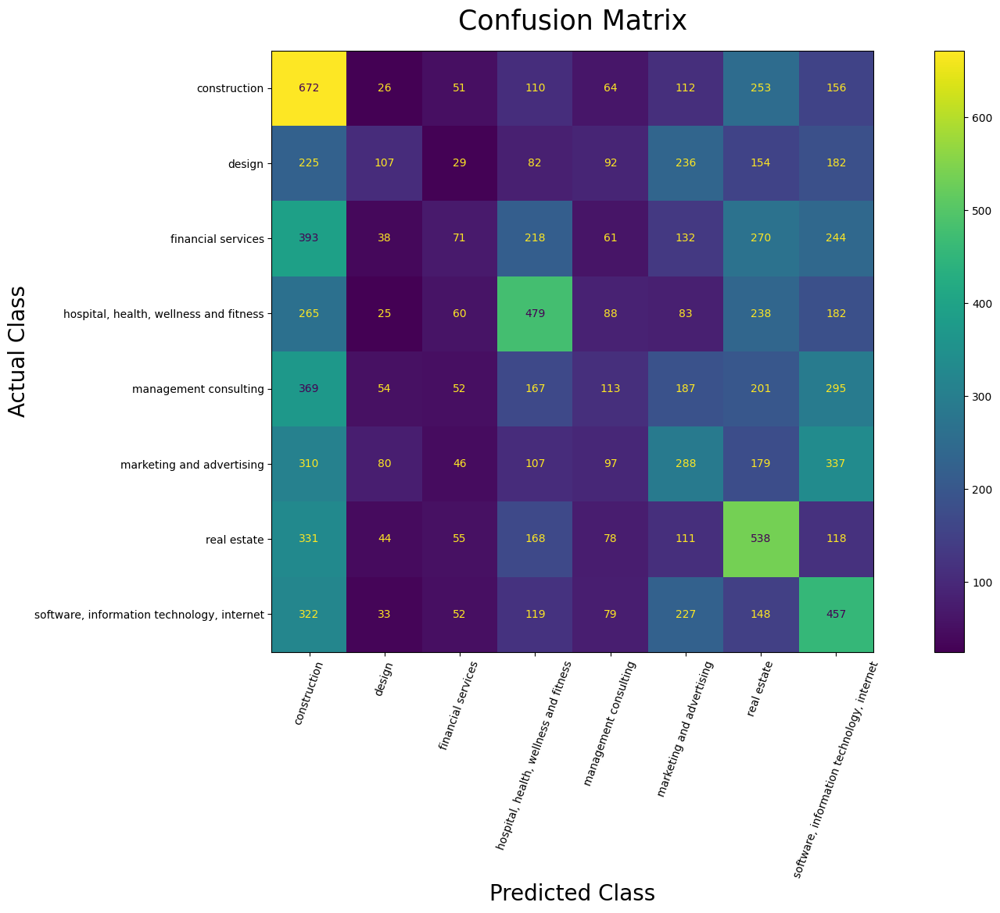

In [69]:

model_resnet50_1 = torchvision.models.resnet50(weights=ResNet50_Weights.DEFAULT)
num_features = model_resnet50_1.fc.in_features
    
# Replace final fully connected layer
model_resnet50_1.fc = nn.Linear(num_features, len(le.classes_))

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(
    filter(lambda p: p.requires_grad, model_resnet50_1.parameters()),
    lr=0.001
)
num_epochs = 2


# Freeze all layers except fc
# for name, param in model_resnet50_1.named_parameters():
#     print(name, param.requires_grad)
    # if 'fc' not in name:
    #     param.requires_grad = False
    # else:
    #     print(name, param.requires_grad)

train_model(model_resnet50_1, train_dataloader, criterion, optimizer, num_epochs, device)
accuracy, labels, predicted = evaluate_model(model_resnet50_1, test_dataloader, device)
print(f'Accuracy on test set: {accuracy:.2f}%')

labels = [tensor.cpu().numpy() if torch.is_tensor(tensor) else tensor for tensor in labels]
predicted = [tensor if isinstance(tensor, np.ndarray) else tensor.cpu().numpy() for tensor in predicted]


plot_confusion_matrix(labels, predicted, le.classes_)

In [29]:
import pickle
with open('/kaggle/input/resnet50-pickles/model_resnet50_1.pkl', 'rb') as f:
    model_resnet50_1 = pickle.load(f)

with open('/kaggle/input/resnet50-pickles/model_resnet50_2.pkl', 'rb') as f:
    model_resnet50_2 = pickle.load(f)

with open('/kaggle/input/resnet50-pickles/model_resnet50_3.pkl', 'rb') as f:
    model_resnet50_2 = pickle.load(f)

Epoch 1/2:  73%|███████▎  | 725/988 [08:54<04:24,  1.01s/it, loss=1.507]libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
Epoch 1/2: 100%|██████████| 988/988 [11:55<00:00,  1.38it/s, loss=2.047]


Epoch 1 Loss: 2.047


Epoch 2/2:  32%|███▏      | 318/988 [03:43<09:48,  1.14it/s, loss=0.650]libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
Epoch 2/2: 100%|██████████| 988/988 [11:46<00:00,  1.40it/s, loss=2.018]


Epoch 2 Loss: 2.018


100%|██████████| 175/175 [01:59<00:00,  1.46it/s]


Accuracy on test set: 22.89%


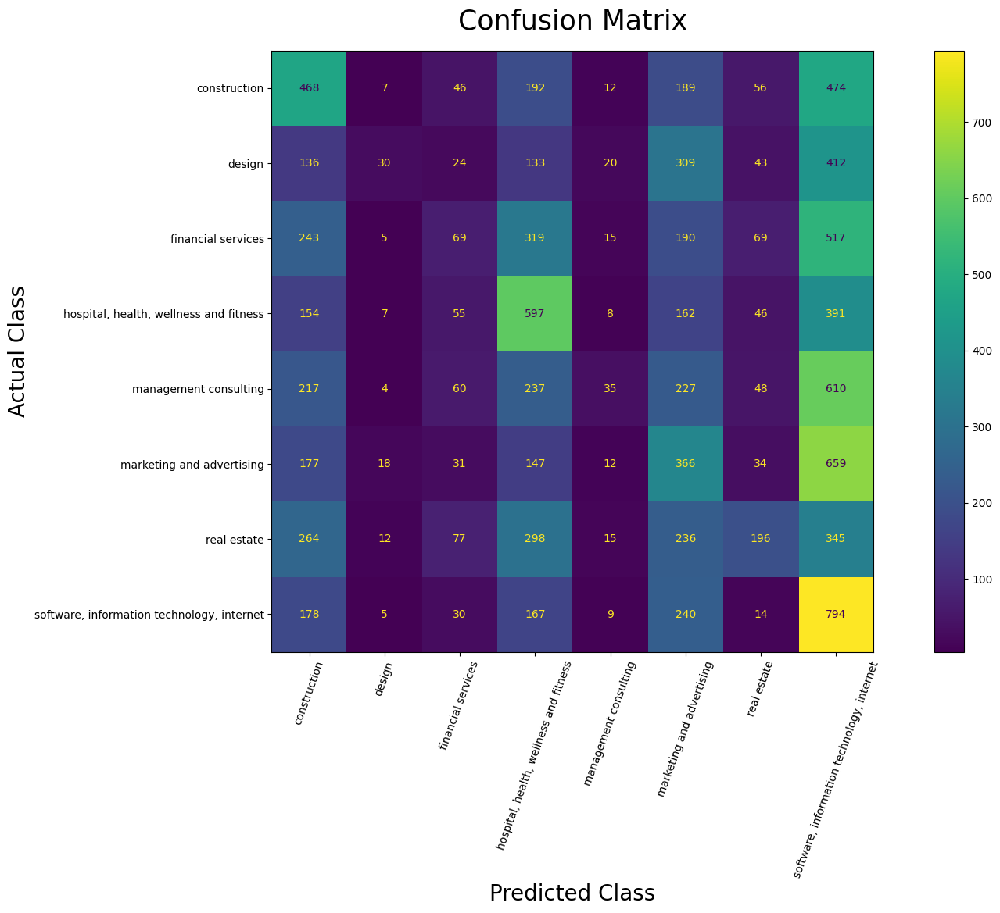

In [22]:
from torchvision.models import ResNet50_Weights
warnings.filterwarnings('ignore')

test_dataset = CompanyLogoDataset(
    test_df['name'].to_list(), 
    ResNet50_Weights.IMAGENET1K_V1.transforms(), 
    test_df['industry'].to_list(),
    label_encoder = le
)

train_dataset = CompanyLogoDataset(
    train_df['name'].to_list(), 
    ResNet50_Weights.IMAGENET1K_V1.transforms(), 
    train_df['industry'].to_list(),
    label_encoder = le
)

train_dataloader = torch.utils.data.DataLoader(
        train_dataset, 
        batch_size=64,
        shuffle=True,
        num_workers=2
)
test_dataloader = torch.utils.data.DataLoader(
        test_dataset, 
        batch_size=64, 
        shuffle=False,
        num_workers=2
)

mixup_transform = transforms.MixUp(
    alpha=1.0,  # Controls interpolation strength
    num_classes=len(le.classes_)  # Specify number of classes in your dataset
)


model_resnet50_2 = torchvision.models.resnet50(weights=ResNet50_Weights.DEFAULT)
num_features = model_resnet50_2.fc.in_features
    
# Replace final fully connected layer
model_resnet50_2.fc = nn.Linear(num_features, len(le.classes_))

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(
    filter(lambda p: p.requires_grad, model_resnet50_2.parameters()),
    lr=0.001
)
num_epochs = 2


# Freeze all layers except fc
# for name, param in model_resnet50_2.named_parameters():
#     print(name, param.requires_grad)
    # if 'fc' not in name:
    #     param.requires_grad = False
    # else:
    #     print(name, param.requires_grad)

train_model(model_resnet50_2, train_dataloader, criterion, optimizer, num_epochs, device, mixup_transform)
accuracy, labels, predicted = evaluate_model(model_resnet50_2, test_dataloader, device)
print(f'Accuracy on test set: {accuracy:.2f}%')
predicted_copy = predicted.copy()
labels = [tensor.cpu().numpy() if torch.is_tensor(tensor) else tensor for tensor in labels]
predicted = [tensor if isinstance(tensor, np.ndarray) else tensor.cpu().numpy() for tensor in predicted]


plot_confusion_matrix(labels, predicted, le.classes_)

Epoch 1/2:   5%|▍         | 48/988 [00:37<07:11,  2.18it/s, loss=0.101]libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
Epoch 1/2: 100%|██████████| 988/988 [11:43<00:00,  1.40it/s, loss=2.056]


Epoch 1 Loss: 2.056


Epoch 2/2:  58%|█████▊    | 577/988 [06:49<04:32,  1.51it/s, loss=1.190]libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
Epoch 2/2: 100%|██████████| 988/988 [11:39<00:00,  1.41it/s, loss=2.034]


Epoch 2 Loss: 2.034


100%|██████████| 175/175 [01:57<00:00,  1.49it/s]


Accuracy on test set: 22.61%


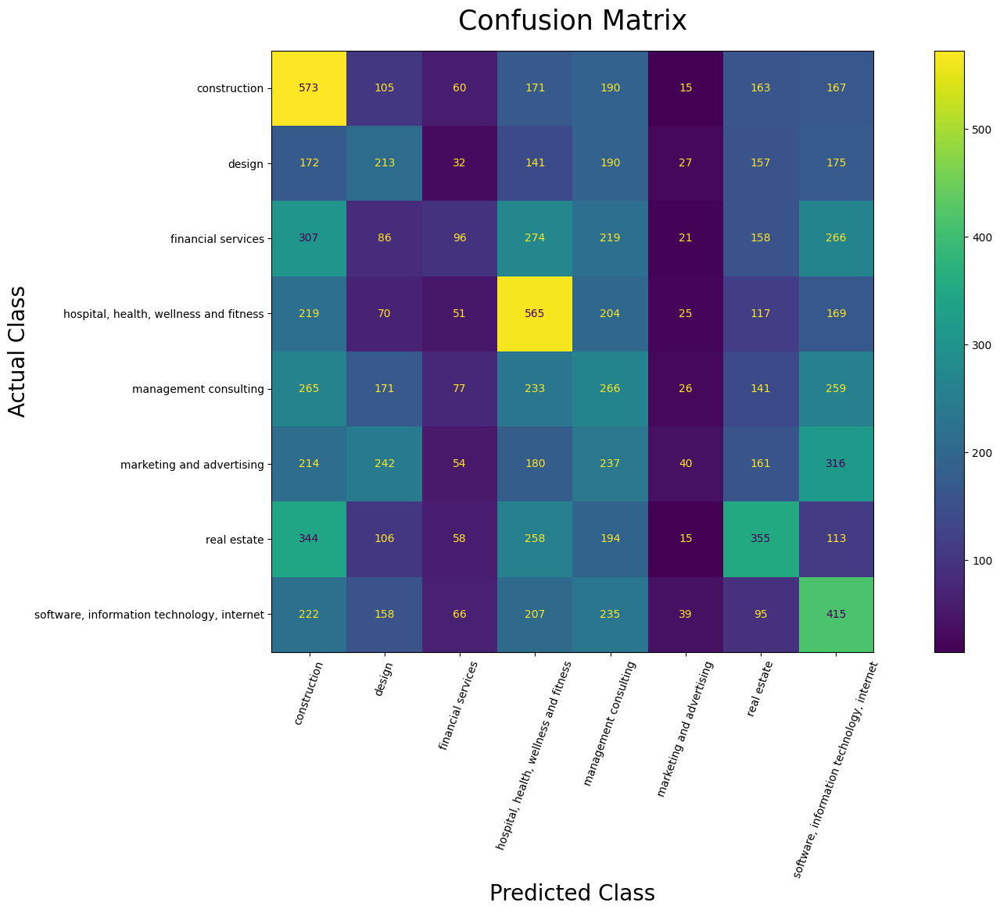

In [26]:
from torchvision.models import ResNet50_Weights
from torchvision.transforms import v2
warnings.filterwarnings('ignore')

# test_dataset = CompanyLogoDataset(
#     test_df['name'].to_list(), 
#     ResNet50_Weights.IMAGENET1K_V1.transforms(), 
#     test_df['industry'].to_list(),
#     label_encoder = le
# )

# train_dataset = CompanyLogoDataset(
#     train_df['name'].to_list(), 
#     ResNet50_Weights.IMAGENET1K_V1.transforms(), 
#     train_df['industry'].to_list(),
#     label_encoder = le
# )

# train_dataloader = torch.utils.data.DataLoader(
#         train_dataset, 
#         batch_size=64,
#         shuffle=True,
#         num_workers=2
# )
# test_dataloader = torch.utils.data.DataLoader(
#         test_dataset, 
#         batch_size=64, 
#         shuffle=False,
#         num_workers=2
# )

mixup_transform = v2.CutMix(
    alpha=1.0,  # Controls interpolation strength
    num_classes=len(le.classes_)  # Specify number of classes in your dataset
)


model_resnet50_2 = torchvision.models.resnet50(weights=ResNet50_Weights.DEFAULT)
num_features = model_resnet50_2.fc.in_features
    
# Replace final fully connected layer
model_resnet50_2.fc = nn.Linear(num_features, len(le.classes_))

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(
    filter(lambda p: p.requires_grad, model_resnet50_2.parameters()),
    lr=0.001
)
num_epochs = 2


# Freeze all layers except fc
# for name, param in model_resnet50_2.named_parameters():
#     print(name, param.requires_grad)
    # if 'fc' not in name:
    #     param.requires_grad = False
    # else:
    #     print(name, param.requires_grad)

train_model(model_resnet50_2, train_dataloader, criterion, optimizer, num_epochs, device, mixup_transform)
accuracy, labels, predicted = evaluate_model(model_resnet50_2, test_dataloader, device)
print(f'Accuracy on test set: {accuracy:.2f}%')
predicted_copy = predicted.copy()
labels = [tensor.cpu().numpy() if torch.is_tensor(tensor) else tensor for tensor in labels]
predicted = [tensor if isinstance(tensor, np.ndarray) else tensor.cpu().numpy() for tensor in predicted]


plot_confusion_matrix(labels, predicted, le.classes_)

In [26]:
import pytesseract
import easyocr

reader = easyocr.Reader(['en'], gpu=True)
def get_logo_text(industry, company_name, index):
    
    if(index % 1000 == 0):
        print(index, end = ' ')

    try:
        img_path = "/kaggle/input/industry-logos/industry/{0}/{1}.jpg".format(industry, company_name)
        # img = Image.open("/kaggle/input/industry-logos/industry/{0}/{1}.jpg".format(industry, company_name))
        # text = pytesseract.image_to_string(img)
        # text = text.replace('\n', ' ').strip()
        # print(img_path)
        results = reader.readtext(img_path)
        text = ' '.join([item[1] for item in results])
        # print(text)
        return text
    except:
        # print(e)
        return ''




In [27]:
warnings.filterwarnings('ignore')
logo_text_arr = industry_df[:25000].apply(lambda x: get_logo_text(x['industry'], x['name'], x.name), axis=1)

0 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


1000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


2000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: profile 'icc': 'GRAY': Gray color space not permitted on RGB PNG
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrec

3000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: profile 'ICC Profile': 'CMYK': invalid ICC profile color space
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile


4000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


5000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB


6000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: profile 'ICC Profile': 'CMYK': invalid ICC profile color space
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


7000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: profile 'ICC Profile': 'CMYK': invalid ICC profile color space
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect 

8000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: profile 'ICC Profile': 'CMYK': invalid ICC profile color space
libpng warning: iCCP: known incorrect sRGB

9000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: cHRM: invalid chromaticities
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


10000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: profile 'ICC Profile': 'CMYK': invalid ICC profile color space
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile


11000 

libpng warning: iCCP: profile 'ICC Profile': 'CMYK': invalid ICC profile color space
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: sRGB: out of place
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB


12000 

libpng warning: iCCP: profile 'ICC Profile': 'CMYK': invalid ICC profile color space
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: sBIT: invalid
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


13000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: gAMA: gamma value out of range
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


14000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: profile 'ICC Profile': 'CMYK': invalid ICC profile color space


15000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: profile 'ICC Profile': 'CMYK': invalid ICC profile color space
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


16000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: profile 'ICC Profile': 'CMYK': invalid ICC profile color space
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile


17000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng error: Read Error
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: profile 'ICC Profile': 'CMYK': invalid ICC profile color space
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


18000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: sRGB: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


19000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


20000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile


21000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
libpng warning: iCCP: CRC error
libpng warning: iCCP: extra compressed data
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng

22000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


23000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: sRGB: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


24000 

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known i

In [31]:
import pickle
logo_text_arr_1 = []
logo_text_arr_2 = []
logo_text_arr_3 = []

with open('/kaggle/input/logo-text-pkl-files/logo_text_arr_1.pkl', 'rb') as f:
    logo_text_arr_1 = list(pickle.load(f))

with open('/kaggle/input/logo-text-pkl-files/logo_text_arr_2.pkl', 'rb') as f:
    logo_text_arr_2 = list(pickle.load(f))

with open('/kaggle/input/logo-text-pkl-files/logo_text_arr_3.pkl', 'rb') as f:
    logo_text_arr_3 = list(pickle.load(f))

logo_text_arr_final = logo_text_arr_1 + logo_text_arr_2 + logo_text_arr_3


In [10]:
logo_text_arr_final = logo_text_arr_1 + logo_text_arr_2 + logo_text_arr_3
len(logo_text_arr_final)

74374

In [34]:
industry_df['logo_text'] = logo_text_arr_final

In [35]:
import torch
import torchvision
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
from transformers import DistilBertTokenizer, DistilBertModel

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
db_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
db_model = DistilBertModel.from_pretrained("distilbert-base-uncased")
db_model.to(device)
all_embeddings = []
batch_size = 100
for i in range(0, len(industry_df['logo_text']), batch_size):
    batch_input = industry_df['logo_text'][i:i+batch_size].to_list()
    encoded_input = db_tokenizer(batch_input, return_tensors='pt', padding=True, truncation=True)
    encoded_input.to(device)
    with torch.no_grad():
        batch_output = db_model(**encoded_input)
        
    embedding = batch_output.last_hidden_state.mean(dim=1)
    all_embeddings.append(embedding)
    # print(i)

copy_embeddings = all_embeddings.copy()
all_embeddings = torch.cat(all_embeddings, dim=0)
all_embeddings = all_embeddings.cpu().numpy()

In [40]:
all_embeddings = torch.cat(all_embeddings, dim=0)


In [43]:
all_embeddings = all_embeddings.cpu().numpy()

In [48]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression


industry_list = industry_df['industry']
embeddings_train, embeddings_test, industry_train, industry_test = train_test_split(all_embeddings, industry_list, test_size=0.15, random_state=42)
logisticRegression = LogisticRegression(random_state=42, max_iter=1000)
lrmodel = logisticRegression.fit(embeddings_train, industry_train)

industry_pred = lrmodel.predict(embeddings_test)
(industry_pred == industry_test).sum()/industry_pred.shape[0]*100

41.22075826835171

In [38]:
actual_accuracy = (industry_pred == industry_test).sum()/industry_pred.shape[0]*100

In [43]:
actual_accuracy

41.22075826835171

In [41]:
industry_test_bkp = industry_test.copy()

# Creating array which will store the mean absolute errors for every permutation test
industry_test_acc_array = []

# Running 1000 permutations
for i in range(1000):
    # Shuffling the test data 
    np.random.shuffle(industry_test.values)

    # Calculating the mean absolute error between the pred and test values
    industry_test_acc_array.append((industry_pred == industry_test).sum()/industry_pred.shape[0]*100)

# Calculating the percentage of valu
p_val = (industry_test_acc_array >= actual_accuracy).sum()/1000
print('p-value: ', p_val)

p-value:  0.0


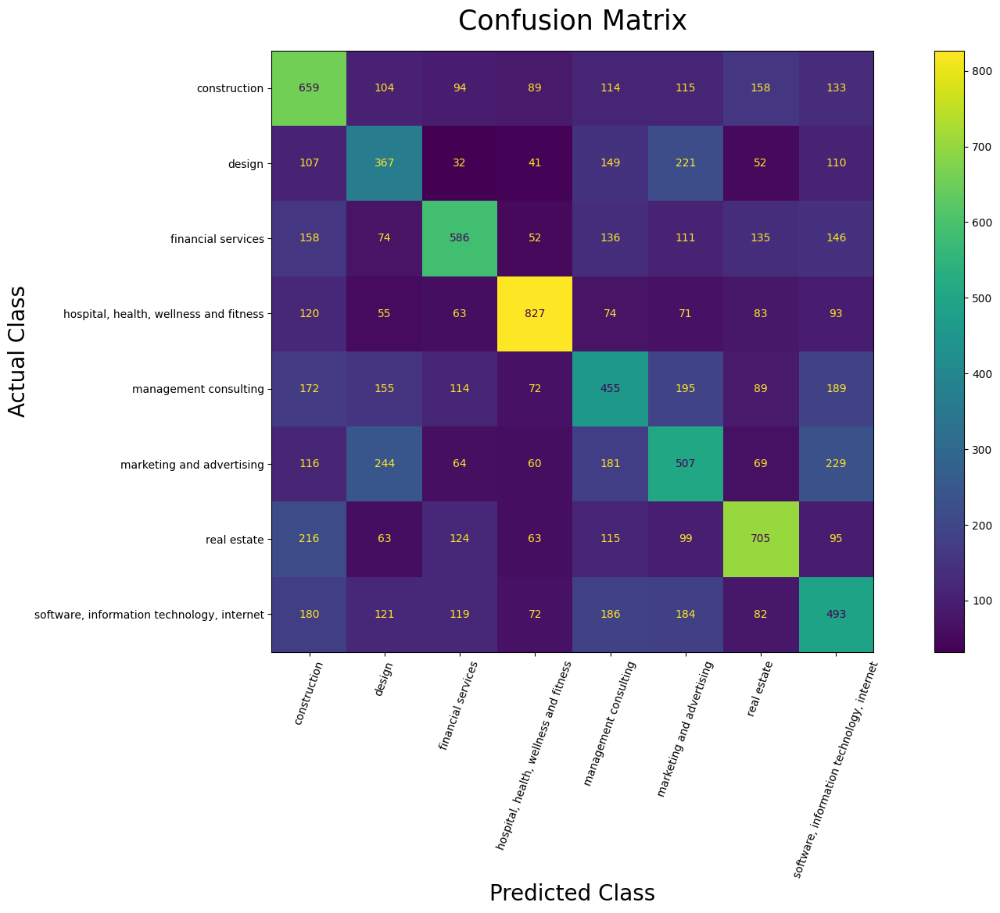

In [64]:
import seaborn as sns

def plot_confusion_matrix_2(labels, predicted, display_labels):
    confusion_matrix = metrics.confusion_matrix(labels, predicted, labels=display_labels)
    cm_cosine_display = metrics.ConfusionMatrixDisplay(confusion_matrix, display_labels=display_labels)
    fig, ax = plt.subplots(figsize=(20, 10))
    
    cm_cosine_display.plot(ax=ax)
    # sns.heatmap(confusion_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=display_labels, yticklabels=display_labels)
    plt.xticks(rotation=70)
    # plt.yticks(size=15, rotation=30)
    plt.xlabel('Predicted Class', fontdict={'fontsize':20})
    plt.ylabel('Actual Class', fontdict={'fontsize':20})
    plt.title('Confusion Matrix', fontdict={'fontsize':25}, pad=20)
    # plt
    plt.show()
    

plot_confusion_matrix_2(industry_test, industry_pred, le.classes_)

In [66]:
report = classification_report(industry_test, industry_pred, target_names=le.classes_, output_dict=True)
report_df = pd.DataFrame(report).transpose()
report_df

,precision,recall,f1-score,support
construction,0.381366,0.449523,0.412649,1466.000000
design,0.310228,0.340130,0.324492,1079.000000
financial services,0.489967,0.419170,0.451812,1398.000000
"hospital, health, wellness and fitness",0.648119,0.596681,0.621337,1386.000000
management consulting,0.322695,0.315753,0.319186,1441.000000
marketing and advertising,0.337325,0.344898,0.341070,1470.000000
real estate,0.513474,0.476351,0.494217,1480.000000
"software, information technology, internet",0.331317,0.343076,0.337094,1437.000000
accuracy,0.412208,0.412208,0.412208,0.412208
macro avg,0.416811,0.410698,0.412732,11157.000000


In [52]:
(industry_pred == industry_test).sum()/industry_pred.shape[0]

0.4122075826835171

In [5]:
industry_df.loc[:, 'logo_text'] = ['' for i in range(industry_df.shape[0])]

Text(0.5, 0.95, 'Gradcam Visualizations for Resnet without Image Augmentation')

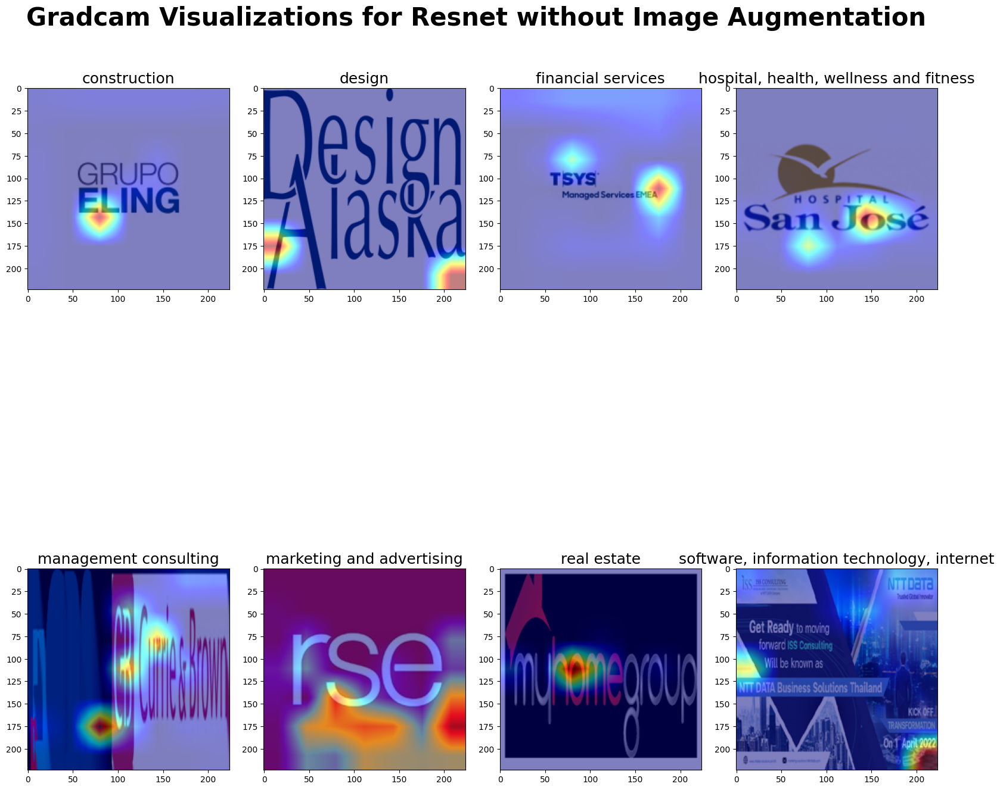

In [ ]:
from pytorch_grad_cam import GradCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, FullGrad
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
from skimage import io, transform
from torchvision.models import ResNet50_Weights

# i = 0
# plt.figure(figsize=(20,20))
target_category = [x for x in range(8)]
fig, ax = plt.subplots(2, 4, constrained_layout=True)
fig.set_size_inches(16, 16)
plt.tight_layout()
plt.subplots_adjust(hspace=0.1)


# plt.tight_layout()
comp_sample_arr = []
for i in range(len(target_category)):
    industry = le.classes_[i]
    company = np.random.choice(os.listdir(f'/kaggle/input/industry-logos/industry/{industry}'), 1).item()
    img_path = f'/kaggle/input/industry-logos/industry/{industry}/{company}'
    logo = io.imread(img_path)
    comp_sample_arr.append(company)
    if logo.shape[0] == 1:
        logo = np.squeeze(logo, axis=0)  # Remove the first dimension
    
    if logo.ndim == 2:  # Grayscale
        logo = np.stack((logo,)*3, axis=-1)
    elif logo.ndim > 3:  # Extra dimensions
        logo = np.squeeze(logo)
    if logo.ndim > 3:
        logo = logo.reshape(logo.shape[-3:])
            
            # Ensure uint8 type
    if logo.dtype != np.uint8:
        if logo.max() <= 1.0:
            logo = (logo * 255).astype(np.uint8)
        else:
            logo = logo.astype(np.uint8)
    model_resnet50_1.eval()
    for param in model_resnet50_1.parameters():
        param.requires_grad = True

    logo = Image.fromarray(logo).convert('RGB')
    resnet50_Transform = ResNet50_Weights.IMAGENET1K_V1.transforms()
    logo_transformed = resnet50_Transform(logo)
    logo_transformed = logo_transformed.unsqueeze(0)
    rgb_img = np.array(logo.resize((224, 224))).astype(np.float32) / 255.0
    targets = [ClassifierOutputTarget(i)]
    target_layers = [model_resnet50_1.layer4[-1]]
    cam = GradCAM(model=model_resnet50_1, target_layers=target_layers)
    grayscale_cam = cam(input_tensor=logo_transformed,targets= targets)
    grayscale_cam = grayscale_cam[0, :]
    visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
    ax[i // 4, i % 4].imshow(visualization)
    ax[i // 4, i % 4].set_title(industry, fontdict={'fontsize': 18})

fig.suptitle('Gradcam Visualizations for Resnet without Image Augmentation', 
             fontsize=30, 
             fontweight='bold', 
             y=0.95) 


Text(0.5, 0.95, 'Gradcam Visualizations for Resnet with Image Augmentation')

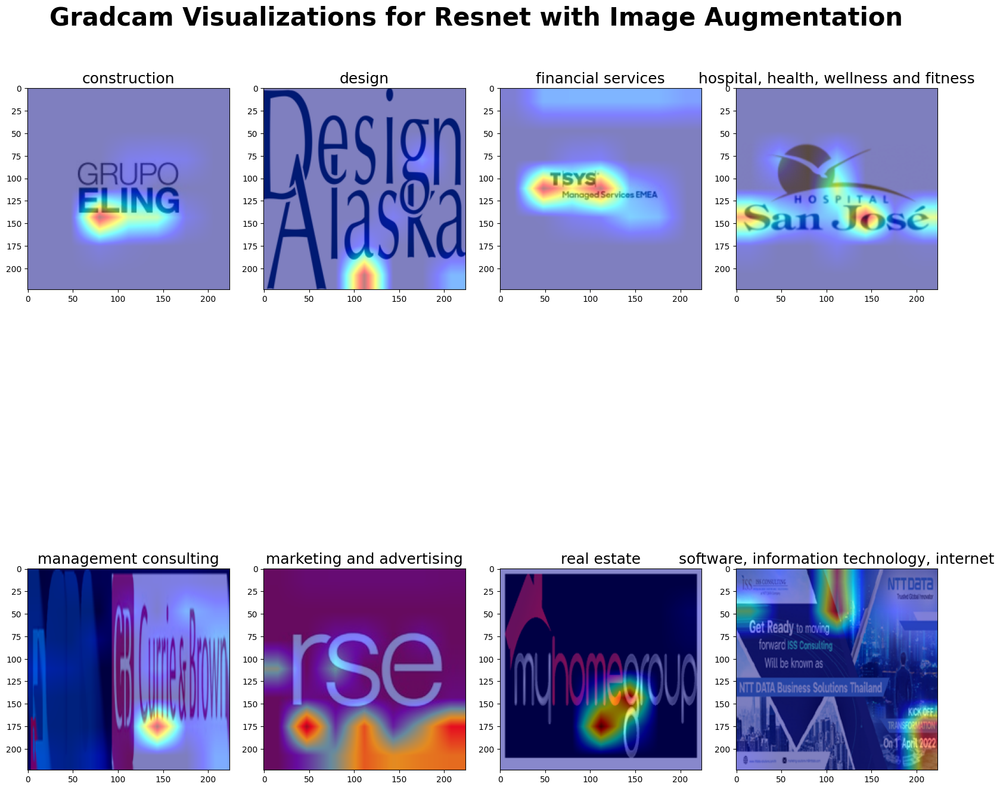

In [70]:
fig, ax = plt.subplots(2, 4, constrained_layout=True)
fig.set_size_inches(16, 16)
plt.tight_layout()
plt.subplots_adjust(hspace=0.1)

for i in range(len(target_category)):
    industry = le.classes_[i]
    company = comp_sample_arr[i]
    img_path = f'/kaggle/input/industry-logos/industry/{industry}/{company}'
    logo = io.imread(img_path)
    # comp_sample_arr.append(company)
    if logo.shape[0] == 1:
        logo = np.squeeze(logo, axis=0)  # Remove the first dimension
    
    if logo.ndim == 2:  # Grayscale
        logo = np.stack((logo,)*3, axis=-1)
    elif logo.ndim > 3:  # Extra dimensions
        logo = np.squeeze(logo)
    if logo.ndim > 3:
        logo = logo.reshape(logo.shape[-3:])
            
            # Ensure uint8 type
    if logo.dtype != np.uint8:
        if logo.max() <= 1.0:
            logo = (logo * 255).astype(np.uint8)
        else:
            logo = logo.astype(np.uint8)
    model_resnet50_1.eval()
    for param in model_resnet50_1.parameters():
        param.requires_grad = True

    logo = Image.fromarray(logo).convert('RGB')
    resnet50_Transform = ResNet50_Weights.IMAGENET1K_V1.transforms()
    logo_transformed = resnet50_Transform(logo)
    logo_transformed = logo_transformed.unsqueeze(0)
    rgb_img = np.array(logo.resize((224, 224))).astype(np.float32) / 255.0
    targets = [ClassifierOutputTarget(i)]
    target_layers = [model_resnet50_2.layer4[-1]]
    cam = GradCAM(model=model_resnet50_2, target_layers=target_layers)
    grayscale_cam = cam(input_tensor=logo_transformed,targets= targets)
    grayscale_cam = grayscale_cam[0, :]
    visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
    ax[i // 4, i % 4].imshow(visualization)
    ax[i // 4, i % 4].set_title(industry, fontdict={'fontsize': 18})
fig.suptitle('Gradcam Visualizations for Resnet with Image Augmentation', 
             fontsize=30, 
             fontweight='bold', 
             y=0.95)

torch.Size([1, 3, 224, 224]) torch.Size([1, 3, 224, 224])


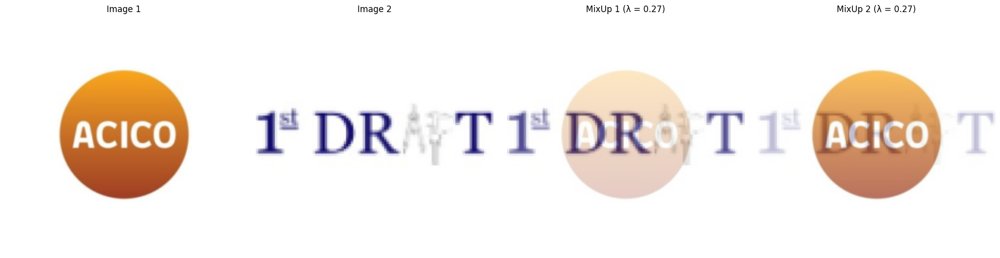

In [86]:
image1 = Image.open('/kaggle/input/industry-logos/industry/construction/acico-group.jpg')
image2 = Image.open('/kaggle/input/industry-logos/industry/design/1st-draft-drafting-services.jpg')

resize_transform = transforms.Resize((224, 224))  # Resize to 256x256 or any desired size
image1 = resize_transform(image1)
image2 = resize_transform(image2)


to_rgb = v2.Compose([
    v2.ToImage(),
    v2.ToDtype(torch.float32, scale=True),
])

to_tensor = transforms.ToTensor()
image1_tensor = to_rgb(image1).unsqueeze(0)
image2_tensor = to_rgb(image2).unsqueeze(0)
image2_tensor = image2_tensor[:, :3, :, :]

print(image1_tensor.shape, image2_tensor.shape)

# Combine into a batch
image_batch = torch.cat([image1_tensor, image2_tensor], dim=0)

labels = torch.tensor([0, 1])
mixup = v2.MixUp(num_classes=2, alpha=1.0)

mixed_images, mixed_labels = mixup(image_batch, labels)

fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 5))

ax1.imshow(image1)
ax1.set_title('Image 1')
ax1.axis('off')

ax2.imshow(image2)
ax2.set_title('Image 2')
ax2.axis('off')

ax3.imshow(mixed_images[0].permute(1, 2, 0).clip(0, 1))
ax3.set_title(f'MixUp 1 (λ = {mixed_labels[0][0]:.2f})')
ax3.axis('off')

ax4.imshow(mixed_images[1].permute(1, 2, 0).clip(0, 1))
ax4.set_title(f'MixUp 2 (λ = {mixed_labels[1][1]:.2f})')
ax4.axis('off')

plt.tight_layout()
plt.show()

torch.Size([1, 3, 224, 224]) torch.Size([1, 3, 224, 224])


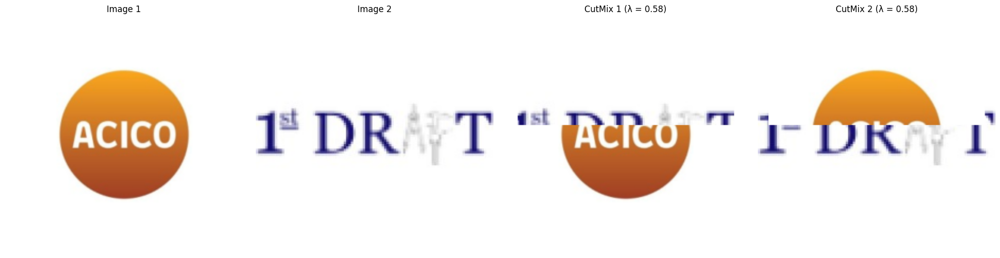

In [88]:
image1 = Image.open('/kaggle/input/industry-logos/industry/construction/acico-group.jpg')
image2 = Image.open('/kaggle/input/industry-logos/industry/design/1st-draft-drafting-services.jpg')

resize_transform = transforms.Resize((224, 224))  # Resize to 256x256 or any desired size
image1 = resize_transform(image1)
image2 = resize_transform(image2)


to_rgb = v2.Compose([
    v2.ToImage(),
    v2.ToDtype(torch.float32, scale=True),
])

to_tensor = transforms.ToTensor()
image1_tensor = to_rgb(image1).unsqueeze(0)
image2_tensor = to_rgb(image2).unsqueeze(0)
image2_tensor = image2_tensor[:, :3, :, :]

print(image1_tensor.shape, image2_tensor.shape)

# Combine into a batch
image_batch = torch.cat([image1_tensor, image2_tensor], dim=0)

labels = torch.tensor([0, 1])
cutmix = v2.CutMix(num_classes=2, alpha=1.0)

mixed_images, mixed_labels = cutmix(image_batch, labels)


fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 5))

ax1.imshow(image1)
ax1.set_title('Image 1')
ax1.axis('off')

ax2.imshow(image2)
ax2.set_title('Image 2')
ax2.axis('off')

ax3.imshow(mixed_images[0].permute(1, 2, 0))
ax3.set_title(f'CutMix 1 (λ = {mixed_labels[0][0]:.2f})')
ax3.axis('off')

ax4.imshow(mixed_images[1].permute(1, 2, 0))
ax4.set_title(f'CutMix 2 (λ = {mixed_labels[1][1]:.2f})')
ax4.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2

def trim_whitespace_cv2(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = 255*(gray < 128).astype(np.uint8)
    gray = cv2.morphologyEx(gray, cv2.MORPH_OPEN, np.ones((2, 2), dtype=np.uint8))
    coords = cv2.findNonZero(gray)
    x, y, w, h = cv2.boundingRect(coords)
    cropped = img[y:y+h, x:x+w]
    
    # Convert BGR to RGB for matplotlib
    cropped_rgb = cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB)
    plt.imshow(cropped_rgb)
    plt.axis('off')
    plt.show()
    
    return cropped


def plot_image(image_path):
    # Read the image
    img = cv2.imread(image_path)
    #print(img)
    
    # Create figure and display image
    #plt.figure(figsize=(10, 8))
    plt.imshow(img)
    plt.axis('off')  # Hide axes
    plt.show()

print("before trim")
plot_image("/kaggle/input/industry-logos/industry/software, information technology, internet/google.jpg")
print("after trim")
trimmed_image = trim_whitespace_cv2("/kaggle/input/industry-logos/industry/software, information technology, internet/google.jpg")

**Color Analysis**

In [ ]:
import os
import pandas as pd
import cv2
import numpy as np
from multiprocessing import Pool
from tqdm import tqdm

# Color detection function
def get_color_names(image_path):
    img = cv2.imread(image_path)
    if img is None:
        return []
    
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    color_ranges = {
        'Red': ([0, 100, 100], [10, 255, 255]),
        'Orange': ([11, 100, 100], [20, 255, 255]),
        'Yellow': ([21, 100, 100], [30, 255, 255]),
        'Lime': ([31, 100, 100], [50, 255, 255]),
        'Green': ([51, 100, 100], [80, 255, 255]),
        'Cyan': ([81, 100, 100], [100, 255, 255]),
        'Blue': ([101, 100, 100], [130, 255, 255]),
        'Purple': ([131, 100, 100], [150, 255, 255]),
        'Magenta': ([151, 100, 100], [170, 255, 255]),
        'Pink': ([171, 100, 100], [180, 255, 255]),
        'Brown': ([0, 100, 20], [20, 255, 100]),
        'Gray': ([0, 0, 50], [180, 50, 200]),
        'Black': ([0, 0, 0], [180, 255, 30]),
        'White': ([0, 0, 200], [180, 30, 255])
    }
    
    detected_colors = set()
    
    for color_name, (lower, upper) in color_ranges.items():
        lower = np.array(lower)
        upper = np.array(upper)
        mask = cv2.inRange(hsv, lower, upper)
        if np.sum(mask) > 0:
            detected_colors.add(color_name)
    
    return list(detected_colors)

# Function to compute whitespace ratio
def calculate_whitespace_ratio(image_path, threshold=200):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        return None
    _, binary = cv2.threshold(img, threshold, 255, cv2.THRESH_BINARY)
    whitespace_ratio = np.sum(binary == 255) / binary.size
    return whitespace_ratio

# Function to process a single logo
def process_single_logo(row, industry_folder, threshold=200):
    logo_file = row['name'].replace(" ", "-").lower() + ".jpg"
    logo_path = os.path.join(industry_folder, row['industry'], logo_file)

    if not os.path.exists(logo_path):
        print(f"Missing logo file: {logo_file}")
        return None

    try:
        # Detect colors
        color_names = get_color_names(logo_path)

        # Compute whitespace ratio
        whitespace_ratio = calculate_whitespace_ratio(logo_path, threshold)

        return {
            "Industry": row['industry'],
            "Logo": row['name'],
            "Detected Colors": color_names,
            "Whitespace Ratio": whitespace_ratio
        }
    except Exception as e:
        print(f"Error processing {logo_path}: {e}")
        return None

# Parallel processing function
def process_logos_parallel(matched_df, industry_folder, threshold=200, cores=4):
    rows = matched_df.to_dict('records')
    results = []
    with Pool(processes=cores) as pool:
        for result in tqdm(
            pool.starmap(process_single_logo, [(row, industry_folder, threshold) for row in rows]),
            total=len(rows),
            desc="Processing Logos"
        ):
            if result:
                results.append(result)
    return results

# Paths to dataset and logos
df_path = "/kaggle/input/industry-df-final/industry_df_0312.csv"
logos_path = "/kaggle/input/industry-logos/industry"

# Load the dataframe
industry_df = pd.read_csv(df_path)

# Filter for industries with logos
logo_industries = os.listdir(logos_path)
matched_df = industry_df[industry_df['industry'].isin(logo_industries)]

print("\nStarting Parallel Processing for Entire Dataset...")

# Run parallel processing
analysis_results = process_logos_parallel(matched_df, logos_path, cores=4)

# Convert results to a DataFrame
results_df = pd.DataFrame(analysis_results)

# Save the results to a separate file
output_path = "/kaggle/working/final_results_with_color_names.csv"
results_df.to_csv(output_path, index=False)

print(f"Final results saved to: {output_path}")

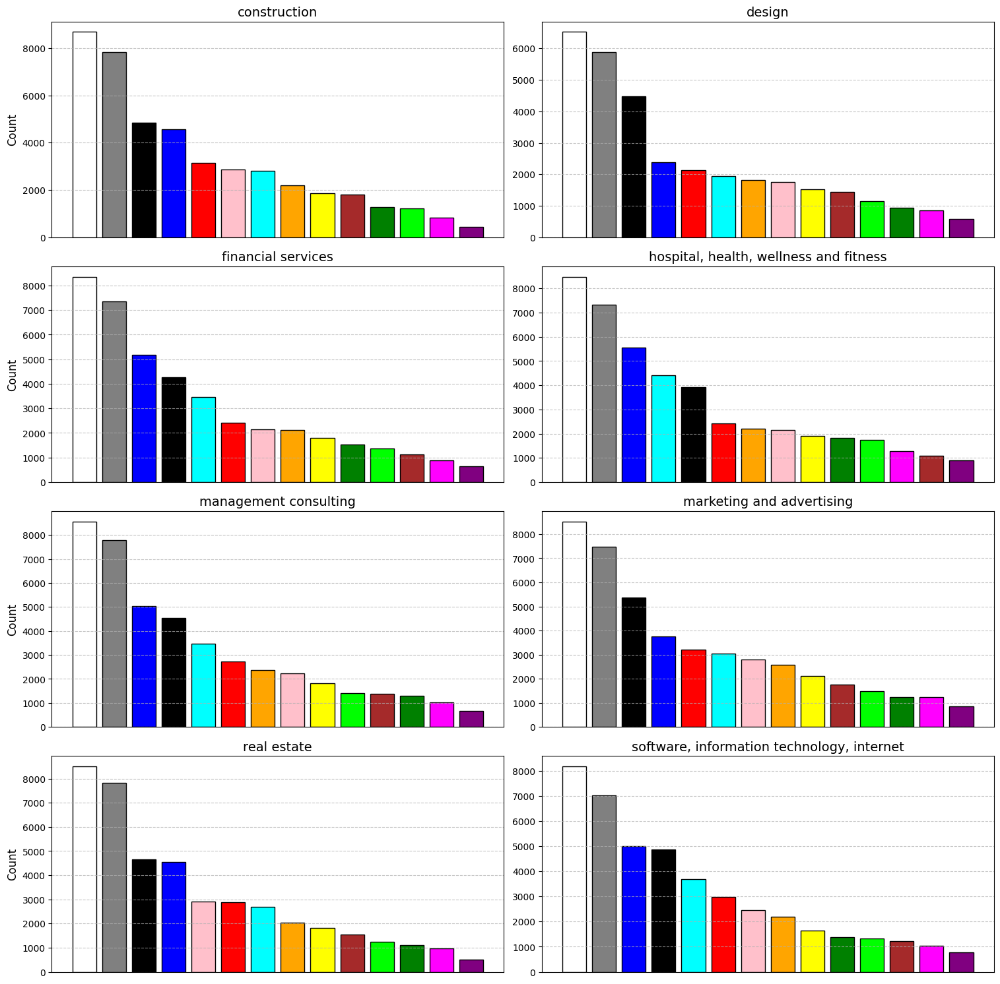

In [19]:
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter
import ast

industry_color = pd.read_csv('/kaggle/input/industrylogo-color/industrylogo_color.csv')
# Example DataFrame
df = industry_color.copy()
fig, ax = plt.subplots(4, 2, figsize=(15, 15))
plt.tight_layout()
i = 0
# Group by industry and plot color counts
for industry, _df in df.groupby('Industry'):
    # Flatten the list of colors for the current industry
    _df['Detected Colors'] = _df['Detected Colors'].apply(ast.literal_eval)
    all_colors = [color for colors in _df['Detected Colors'].to_list() for color in colors]
    
    # Count the frequency of each color
    color_counts = Counter(all_colors)
    
    # Sort colors by decreasing order of count
    sorted_colors = dict(sorted(color_counts.items(), key=lambda item: item[1], reverse=True))
    
    # Plot the frequency
    # plt.figure(figsize=(6, 4))
    # plt.bar(sorted_colors.keys(), sorted_colors.values(), color=sorted_colors.keys(), edgecolor='k')
    # plt.title(f'Color Frequency in {industry}', fontsize=14)
    # plt.xlabel('Colors', fontsize=12)
    # plt.ylabel('Count', fontsize=12)
    # plt.xticks(rotation=45)
    # plt.grid(axis='y', linestyle='--', alpha=0.7)
    # plt.tight_layout()
    # plt.show()

    # ax[i // 4, i % 4].figure(figsize=(6, 4))
    ax[i // 2, i % 2].bar(sorted_colors.keys(), sorted_colors.values(), color=sorted_colors.keys(), edgecolor='k')
    ax[i // 2, i % 2].set_title(f'{industry}', fontsize=14)
    # ax[i // 2, i % 2].set_xlabel('Colors', fontsize=12)
    if(i % 2 == 0):
        ax[i // 2, i % 2].set_ylabel('Count', fontsize=12)
    # ax[i // 2, i % 2].set_xticks(rotation=45)
    ax[i // 2, i % 2].grid(axis='y', linestyle='--', alpha=0.7)
    # plt.tight_layout()
    ax[i // 2, i % 2].set_xticks([])

    i += 1
plt.show()